In [1]:
%load_ext autoreload
%autoreload 2
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import sys, os, gc
import numpy as np
import cv2
import torch
import moviepy.editor as mpy

current_path = rf"{os.getcwd()}"
main_path = os.path.abspath(os.path.dirname(current_path))
sys.path.append(rf"{main_path}")
sys.path.append(rf"{main_path}/src")

import utilities as util
from main import an_inference_engine, video_ad_model_inference_engine, an_ad_offline_result_presenter, cfg

output_dir = cfg.result_path
output_dir
output_dirpath = util.Path(rf"{main_path}/{output_dir}")
output_dirpath.mkdir(exist_ok=True, parents=True)

timer = util.ProcTimer()
timer.display_proctime()
timer.stop()

device = 'cuda' if torch.cuda.is_available() else 'cpu'

%matplotlib inline

process time: 0.0 seconds.


# Video Anonymization and Anomaly Detection

In [2]:
# Configurations
cfg.anony_method_options_list
cfg.object_detection_classname_list
cfg.object_detection_imgsz
cfg.object_detection_thr

cfg.ad_method_options_list
cfg.ad_model_src
cfg.ad_thr

['no-an',
 'mask',
 'edge',
 'blur',
 'adaptive_blur',
 'adaptive_full_blur',
 'adaptive_max_blur',
 'pixelization',
 'adaptive_pixelization',
 'adaptive_max_pixelization']

['person', 'cell phone', 'laptop', 'tv']

(320, 240)

0.15

['pel', 'mgfn']

'xd'

0.5

In [3]:
# Load video file
vid_path = rf"{main_path}/data/XD_Violence/Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0.mp4"
video_frames, video_meta = util.videofile_loader(vid_path, start_sec=0, clip_duration=None, fps=None, target_resolution=None)
print("video_meta: ", video_meta)
mpyVidObj = mpy.ImageSequenceClip(list(map(lambda x: cv2.cvtColor(x, cv2.COLOR_BGR2RGB).astype("uint8"), video_frames)), fps=video_meta["fps"])
mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

videofile_loader...
process time: 0.35852 seconds.
loaded frame duration: 30.08 secs, frame length: 722, fps: 24, resolution: (136, 320, 3)
video_meta:  {'num_frames': 722, 'fps': 24, 'duration': 30.08, 'frame_size': (136, 320, 3)}
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Single AN-VAD Method Inference [MASKED - PEL4VAD]

In [4]:
# Load and setup AN method
anony_method = "mask"
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"color_format":"bgr"}
axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)

# Load and setup VAD method
ad_method = cfg.ad_method_options_list[0]
ad_model_src = "xd"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
##############################
model:  yolov8m-seg.pt
{'method': <function ConventionalImageAnonymizer.silhoutte at 0x0000021B0AF99C60>, 'kwargs': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': []}}
dataset:  xd
loading pretrained checkpoint from c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model\PEL4VAD/

AN-VAD inference...
AN inference...


100%|██████████| 722/722 [00:10<00:00, 71.70it/s]


AN: 10.080 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:06<00:00,  2.00s/it]


obtained features of size:  (45, 5, 1024)
done in 6.082776069641113 sec, features shape: (45, 5, 1025).
AD: 6.121 secs


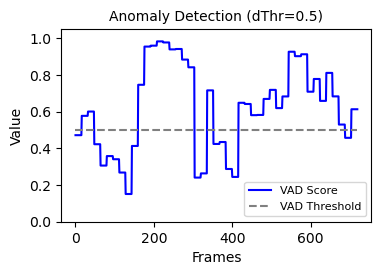

In [5]:
# AN-VAD inference
print("AN-VAD inference...")
ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)

In [6]:
# Display the AN-VAD video
mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [7]:
# Save the anonymized video and VAD score figure
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])
frame_size = video_frames[0].shape[:2]  # (width, height)
result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
if ad_score_fig is not None:
    util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
if an_ad_frame_list is not None:
    util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4


## XD-Violence Dataset Example

In [8]:
# Load video file
vid_path = rf"{main_path}/data/XD_Violence/Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0.mp4"
video_frames, video_meta = util.videofile_loader(vid_path, start_sec=0, clip_duration=None, fps=None, target_resolution=None)
print("video_meta: ", video_meta)
mpyVidObj = mpy.ImageSequenceClip(list(map(lambda x: cv2.cvtColor(x, cv2.COLOR_BGR2RGB).astype("uint8"), video_frames)), fps=video_meta["fps"])
mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

videofile_loader...
process time: 0.44486 seconds.
loaded frame duration: 30.08 secs, frame length: 722, fps: 24, resolution: (136, 320, 3)
video_meta:  {'num_frames': 722, 'fps': 24, 'duration': 30.08, 'frame_size': (136, 320, 3)}
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


### All AN Methods with VAD-PEL4VAD

dataset:  xd
loading pretrained checkpoint from c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model\PEL4VAD/ckpt/xd__8526.pkl.
dataset:  xd
VideoFeatureExtractor: feature_dim=1024, pretrainedpath=c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model/VIDEO_ENCODER_RESNET_1024/models/i3d/ckpt/i3d_rgb.pt
{'frequency': 16, 'sample_T': 5}
All AN Methods: ['no-an', 'mask', 'edge', 'blur', 'adaptive_blur', 'adaptive_full_blur', 'adaptive_max_blur', 'pixelization', 'adaptive_pixelization', 'adaptive_max_pixelization']
####################################################################################################
Processing with anonymization method: NO-AN
####################################################################################################
init_anonymizer...
{'detector_name': 'image', 'kwargs_anony_method': {'color_format': 'bgr', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_sc

100%|██████████| 722/722 [00:00<?, ?it/s]


AN: 0.003 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.87s/it]


obtained features of size:  (45, 5, 1024)
done in 5.644488573074341 sec, features shape: (45, 5, 1025).
AD: 5.655 secs


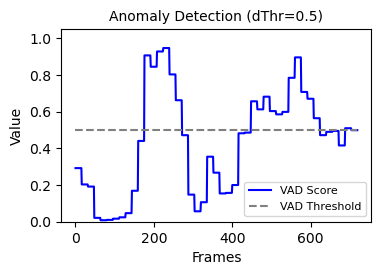

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: no-an


11835

####################################################################################################
####################################################################################################
Processing with anonymization method: MASK
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
############

100%|██████████| 722/722 [00:09<00:00, 75.65it/s]


AN: 9.545 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.88s/it]


obtained features of size:  (45, 5, 1024)
done in 5.699327707290649 sec, features shape: (45, 5, 1025).
AD: 5.707 secs


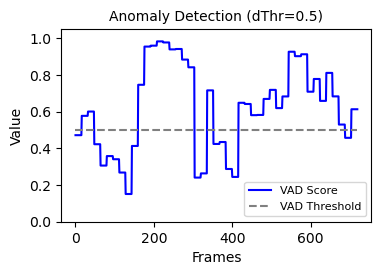

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: mask


66

####################################################################################################
####################################################################################################
Processing with anonymization method: EDGE
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'thr1': 100, 'thr2': 200, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
####################

100%|██████████| 722/722 [00:10<00:00, 69.73it/s]


AN: 10.357 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.92s/it]


obtained features of size:  (45, 5, 1024)
done in 5.809814691543579 sec, features shape: (45, 5, 1025).
AD: 5.824 secs


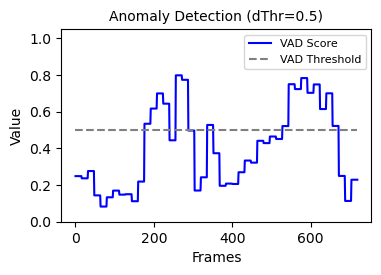

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: edge


4428

####################################################################################################
####################################################################################################
Processing with anonymization method: BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320,

100%|██████████| 722/722 [00:11<00:00, 62.46it/s]


AN: 11.564 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.91s/it]


obtained features of size:  (45, 5, 1024)
done in 5.770061492919922 sec, features shape: (45, 5, 1025).
AD: 5.777 secs


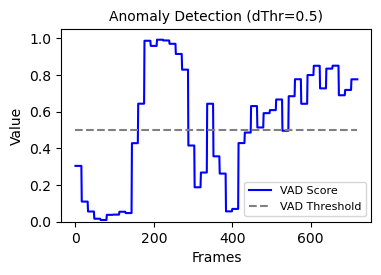

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: blur


4425

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': False, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.p

100%|██████████| 722/722 [00:12<00:00, 59.73it/s]


AN: 12.091 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.89s/it]


obtained features of size:  (45, 5, 1024)
done in 5.730185031890869 sec, features shape: (45, 5, 1025).
AD: 5.736 secs


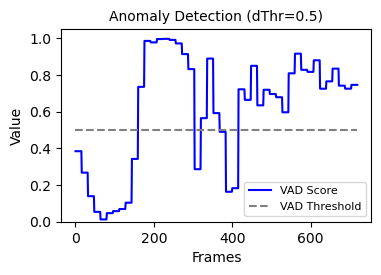

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_blur


4425

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_FULL_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-s

100%|██████████| 722/722 [00:10<00:00, 66.14it/s]


AN: 10.918 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.71s/it]


obtained features of size:  (45, 5, 1024)
done in 5.174890041351318 sec, features shape: (45, 5, 1025).
AD: 5.180 secs


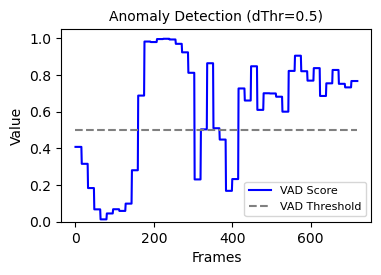

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_full_blur


4425

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_MAX_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (0, 0), 'sigma': (0, 0), 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz

100%|██████████| 722/722 [00:19<00:00, 36.93it/s]


AN: 19.555 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.99s/it]


obtained features of size:  (45, 5, 1024)
done in 5.99481987953186 sec, features shape: (45, 5, 1025).
AD: 6.002 secs


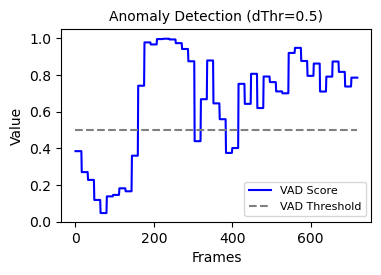

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_max_blur


4428

####################################################################################################
####################################################################################################
Processing with anonymization method: PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cu

100%|██████████| 722/722 [00:10<00:00, 68.43it/s]


AN: 10.554 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.86s/it]


obtained features of size:  (45, 5, 1024)
done in 5.625556707382202 sec, features shape: (45, 5, 1025).
AD: 5.631 secs


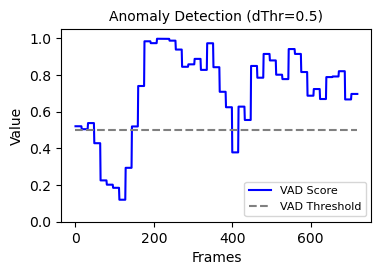

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: pixelization


4428

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'i

100%|██████████| 722/722 [00:10<00:00, 69.03it/s]


AN: 10.462 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.88s/it]


obtained features of size:  (45, 5, 1024)
done in 5.6722190380096436 sec, features shape: (45, 5, 1025).
AD: 5.679 secs


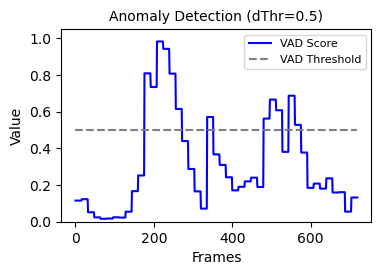

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_pixelization


4425

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_MAX_PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 0, 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), '

100%|██████████| 722/722 [00:13<00:00, 54.11it/s]


AN: 13.346 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.81s/it]


obtained features of size:  (45, 5, 1024)
done in 5.457072734832764 sec, features shape: (45, 5, 1025).
AD: 5.464 secs


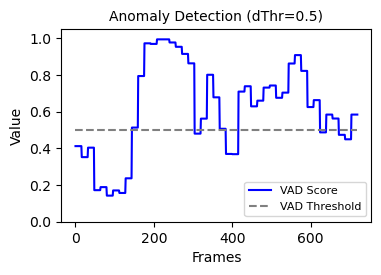

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/pel_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_max_pixelization


4425

####################################################################################################


In [9]:
# General setup for AN inference
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"alpha_mask_scale":1.0, "alpha_dim_scale":0.5, "color_format":"bgr"}

# Load and setup for VAD inference
ad_method = cfg.ad_method_options_list[0] # pel4
ad_model_src = "xd"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

# output filename extraction
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])

# Iterate through all anonymization methods
print("All AN Methods:", cfg.anony_method_options_list)

for anony_method in cfg.anony_method_options_list:
    print("#"*100)
    print(f"Processing with anonymization method: {anony_method.upper()}")  # Use upper() for better visibility
    print("#"*100)

    axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)
    
   # AN-VAD inference
    print("AN-VAD inference...")
    ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)
         
    # Display the AN0VAD score figure
    ad_score_fig
    
    # Display the AN-VAD video
    mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
    mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

    # Save the anonymized video and VAD score figure
    frame_size = video_frames[0].shape[:2]  # (width, height)
    result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
    if ad_score_fig is not None:
        util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
    if an_ad_frame_list is not None:
        util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)
    
    print("Processing completed for method:", anony_method)
    gc.collect()  # Clear memory after each iteration
    print("#"*100)

    # break

### All AN Methods with VAD-MGFN

dataset:  xd
Loaded model from c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model\MGFN/ckpt/mgfn_xd.pkl
VideoFeatureExtractor: feature_dim=1024, pretrainedpath=c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\src\model/VIDEO_ENCODER_RESNET_1024/models/i3d/ckpt/i3d_rgb.pt
{'frequency': 16, 'sample_T': 5}
All AN Methods: ['no-an', 'mask', 'edge', 'blur', 'adaptive_blur', 'adaptive_full_blur', 'adaptive_max_blur', 'pixelization', 'adaptive_pixelization', 'adaptive_max_pixelization']
####################################################################################################
Processing with anonymization method: NO-AN
####################################################################################################
init_anonymizer...
{'detector_name': 'image', 'kwargs_anony_method': {'color_format': 'bgr', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5},

100%|██████████| 722/722 [00:00<?, ?it/s]


AN: 0.003 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.83s/it]


obtained features of size:  (45, 5, 1024)
done in 5.523411750793457 sec, features shape: (45, 5, 1025).


1it [00:00, 10.46it/s]


AD: 5.623 secs


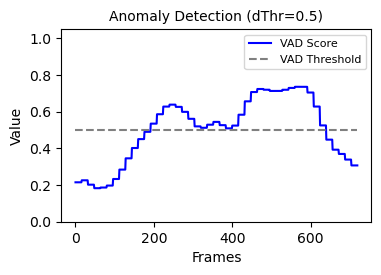

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_no-an_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: no-an


38514

####################################################################################################
####################################################################################################
Processing with anonymization method: MASK
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'alpha': 1.0, 'color': '#000000', 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
############

100%|██████████| 722/722 [00:08<00:00, 81.51it/s]


AN: 8.860 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.93s/it]


obtained features of size:  (45, 5, 1024)
done in 5.828355550765991 sec, features shape: (45, 5, 1025).


1it [00:00, 129.67it/s]


AD: 5.842 secs


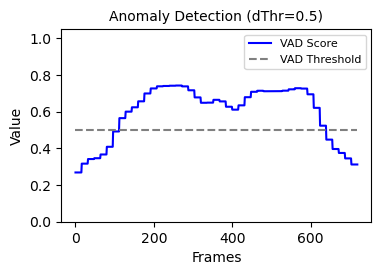

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_mask_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: mask


47

####################################################################################################
####################################################################################################
Processing with anonymization method: EDGE
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'thr1': 100, 'thr2': 200, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}
####################

100%|██████████| 722/722 [00:09<00:00, 73.08it/s]


AN: 9.882 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.82s/it]


obtained features of size:  (45, 5, 1024)
done in 5.4931159019470215 sec, features shape: (45, 5, 1025).


1it [00:00, 130.33it/s]


AD: 5.506 secs


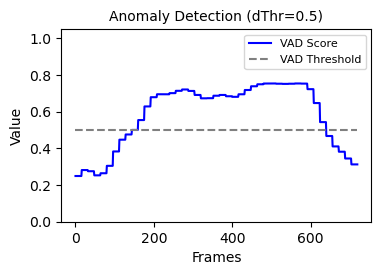

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_edge_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: edge


4409

####################################################################################################
####################################################################################################
Processing with anonymization method: BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320,

100%|██████████| 722/722 [00:09<00:00, 76.57it/s]


AN: 9.432 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.77s/it]


obtained features of size:  (45, 5, 1024)
done in 5.340931415557861 sec, features shape: (45, 5, 1025).


1it [00:00, 137.07it/s]


AD: 5.353 secs


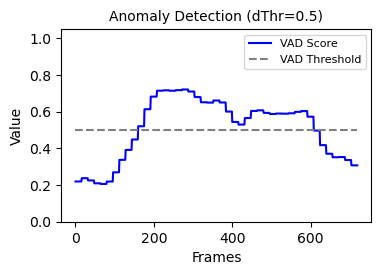

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: blur


4406

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': False, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.p

100%|██████████| 722/722 [00:10<00:00, 68.95it/s]


AN: 10.472 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.77s/it]


obtained features of size:  (45, 5, 1024)
done in 5.345524311065674 sec, features shape: (45, 5, 1025).


1it [00:00, 117.38it/s]


AD: 5.358 secs


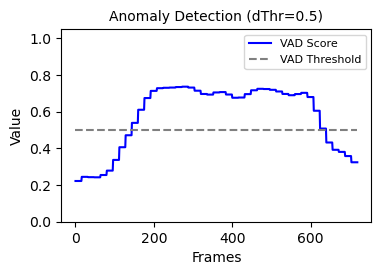

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_blur


4406

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_FULL_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (13, 13), 'sigma': (10, 10), 'use_adaptive_mask': True, 'adaptive_sigma': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-s

100%|██████████| 722/722 [00:11<00:00, 65.19it/s]


AN: 11.078 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.77s/it]


obtained features of size:  (45, 5, 1024)
done in 5.335392475128174 sec, features shape: (45, 5, 1025).


1it [00:00, 116.01it/s]


AD: 5.349 secs


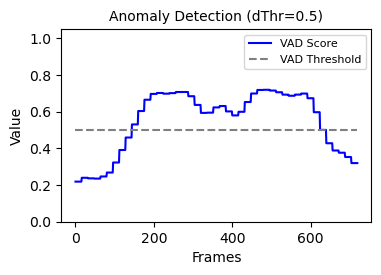

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_full_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_full_blur


4406

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_MAX_BLUR
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'kernelsize': (0, 0), 'sigma': (0, 0), 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz

100%|██████████| 722/722 [00:19<00:00, 36.35it/s]


AN: 19.863 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.92s/it]


obtained features of size:  (45, 5, 1024)
done in 5.788864374160767 sec, features shape: (45, 5, 1025).


1it [00:00, 123.07it/s]


AD: 5.803 secs


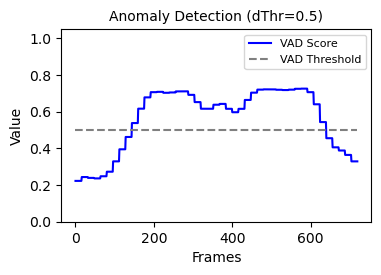

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_blur_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_max_blur


4409

####################################################################################################
####################################################################################################
Processing with anonymization method: PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': False, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cu

100%|██████████| 722/722 [00:10<00:00, 67.11it/s]


AN: 10.759 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.99s/it]


obtained features of size:  (45, 5, 1024)
done in 6.012672424316406 sec, features shape: (45, 5, 1025).


1it [00:00, 103.77it/s]


AD: 6.029 secs


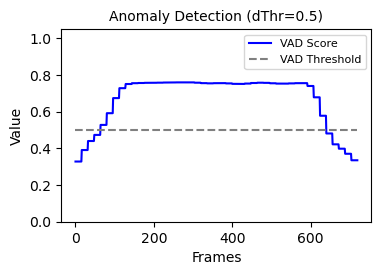

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: pixelization


4409

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 4, 'use_adaptive_mask': True, 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5, 'use_log_scaler': True, 'preprocessors_list': [], 'postprocessors_list': []}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'i

100%|██████████| 722/722 [00:11<00:00, 63.97it/s]


AN: 11.288 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.94s/it]


obtained features of size:  (45, 5, 1024)
done in 5.865412950515747 sec, features shape: (45, 5, 1025).


1it [00:00, 115.27it/s]


AD: 5.878 secs


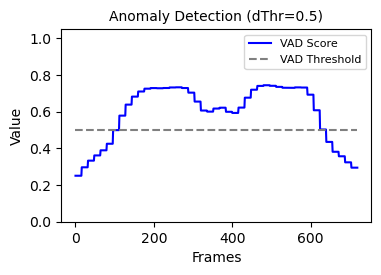

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_pixelization


4406

####################################################################################################
####################################################################################################
Processing with anonymization method: ADAPTIVE_MAX_PIXELIZATION
####################################################################################################
init_anonymizer...
{'detector_name': 'body__yolo', 'kwargs_anony_method': {'color_format': 'bgr', 'downsize': 0, 'use_adaptive_mask': True, 'preprocessors_list': [], 'postprocessors_list': [], 'alpha_mask_scale': 1.0, 'alpha_dim_scale': 0.5}, 'kwargs_detector_method': {'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), 'device': 'cuda'}, 'target_resolution': None, 'isreset_cache': False}
loading object detector...
{'anony_type': 'body', 'seg_type': 'instant', 'detector_version': 'yolov8m-seg.pt', 'detection_thr': 0.15, 'classes': [0], 'imgsz': (320, 240), '

100%|██████████| 722/722 [00:10<00:00, 66.63it/s]


AN: 10.839 secs
AD inference...
VAD Inference...
extracting features...
run...device: cuda, batch_size: 20...
frame_cnt: 722
frame_indices:  3, batch_num: 3


100%|██████████| 3/3 [00:05<00:00,  1.98s/it]


obtained features of size:  (45, 5, 1024)
done in 5.9728264808654785 sec, features shape: (45, 5, 1025).


1it [00:00, 117.35it/s]


AD: 5.988 secs


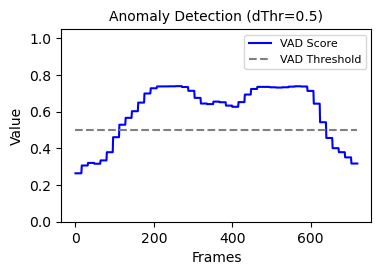

saving to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results
saving video to  c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Moviepy - Building video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4.
Moviepy - Writing video c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\mulugetawa\OneDrive - Universitetet i Agder\UiA\Projects\AI4CITIZEN\LA3D\results/mgfn_xd_adaptive_max_pixelization_imwh320x136_Fast.Five.2011__#00-32-56_00-33-26_label_B2-0-0_ad.mp4
Processing completed for method: adaptive_max_pixelization


4409

####################################################################################################


In [10]:
# General setup for AN inference
object_detection_classes = ['person']
kwargs_detector_method = {"classes":[cfg.object_detection_classid_mapper_dict[classname] for classname in object_detection_classes], 
                              "detection_thr":cfg.object_detection_thr, 
                              "imgsz":cfg.object_detection_imgsz,
                              "device":"cuda"}
kwargs_anony_method = {"alpha_mask_scale":1.0, "alpha_dim_scale":0.5, "color_format":"bgr"}

# Load and setup for VAD inference
ad_method = cfg.ad_method_options_list[1]  # mgfn
ad_model_src = "xd"
ad_thr = 0.5
kwargs_ad_method = {"ad_model_src":ad_model_src, "ad_thr":ad_thr}
axisADObj = video_ad_model_inference_engine(ad_method=ad_method, kwargs_ad_method=kwargs_ad_method)

# output filename extraction
filename = ".".join(util.Path(vid_path).name.split(".")[:-1])

# Iterate through all anonymization methods
print("All AN Methods:", cfg.anony_method_options_list)

for anony_method in cfg.anony_method_options_list:
    print("#"*100)
    print(f"Processing with anonymization method: {anony_method.upper()}")  # Use upper() for better visibility
    print("#"*100)

    axisANObj = an_inference_engine(anony_method, 
                                object_detection_classes = ['person'],
                                kwargs_detector_method=kwargs_detector_method,
                                kwargs_anony_method=kwargs_anony_method)
    
   # AN-VAD inference
    print("AN-VAD inference...")
    ad_score_fig, an_ad_frame_list = an_ad_offline_result_presenter(axisANObj, axisADObj, video_frames)
         
    # Display the AN0VAD score figure
    ad_score_fig
    
    # # Display the AN-VAD video, commented to avoid large .ipynb output and enable git push without LFS
    # mpyVidObj = mpy.ImageSequenceClip(an_ad_frame_list, fps=video_meta["fps"])
    # mpyVidObj.ipython_display(width=480, height=360, fps=video_meta["fps"], maxduration=video_meta["duration"]+1, autoplay=True)

    # Save the anonymized video and VAD score figure
    frame_size = video_frames[0].shape[:2]  # (width, height)
    result_filename_template = f'{ad_method}_{ad_model_src}_{anony_method}_imwh{frame_size[1]}x{frame_size[0]}_{filename}'
    if ad_score_fig is not None:
        util.save_figure(ad_score_fig, f'{result_filename_template}_ad', output_dirpath, dpi=100, format="jpg", issave=True, isshow=False)
    if an_ad_frame_list is not None:
        util.save_video(an_ad_frame_list, video_meta["fps"], rf'{result_filename_template}_ad', output_dirpath)
    
    print("Processing completed for method:", anony_method)
    gc.collect()  # Clear memory after each iteration
    print("#"*100)

    # break